## Sim Demo

### Imports

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from env.imports import *

/ext3/miniconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (
2025-08-29 10:00:06.440044: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-08-29 10:00:07.452289: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI AVX512_BF16 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-08-29 10:00:08.644057: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
  import numpy.matlib 

In [3]:
import importlib
import data

import models
import sim.sim
import sim.sim_utils
from sim.sim_utils import bytes2human, print_system_usage
from sim.sim import Simulation
from sim.sim_run import single_sim_run

importlib.reload(sim.sim)
importlib.reload(sim.sim_run)
importlib.reload(models.train_val)
importlib.reload(data.data_utils)


<module 'data.data_utils' from '/scratch/asr655/neuroinformatics/GeneEx2Conn/data/data_utils.py'>

#### Check job specs

In [4]:
print_system_usage()

total = psutil.disk_usage('/').total
print(bytes2human(total))

CPU Usage: 2.8%
RAM Usage: 7.5%
Available RAM: 1.4T
Total RAM: 1.5T
52.4G


In [5]:
print(os.environ.get("CUDA_VISIBLE_DEVICES"))

# Check available GPUs
print(f"Available GPUs: {torch.cuda.device_count()}")

for i in range(torch.cuda.device_count()):
    print(f"GPU {i}: {torch.cuda.get_device_name(i)} - Memory Allocated: {torch.cuda.memory_allocated(i)/1024**3:.2f} GB")


0
Available GPUs: 1
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.00 GB


In [6]:
print("XGBoost version:", xgboost.__version__)
print("cupy version:", cp.__version__)

GPUtil.getAvailable()

# if a number is seen a GPU is available
GPUtil.getGPUs()

DEVICE_ID_LIST = GPUtil.getFirstAvailable()
DEVICE_ID = DEVICE_ID_LIST[0] # grab first element from list
if DEVICE_ID != None: 
    print('GPU found', DEVICE_ID)
    use_gpu = True

    GPUtil.showUtilization()

XGBoost version: 2.0.3
cupy version: 13.1.0
GPU found 0
| ID | GPU | MEM |
------------------
|  0 |  0% |  0% |


In [7]:
torch.cuda.is_available()

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

## Simulation tests <a id="sims"></a>

In [ ]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=True,
              dataset='HCP',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='spatial',
              random_seed=42,
              search_method=('wandb', 'mse', 4),
              track_wandb=False,
              skip_cv=True,
              model_type='dynamic_mlp',
              use_gpu=True,
              null_model='none',
              use_folds=[0]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 11988, Number of 0s: 195948, Class balance (1s): 0.058
X shape: (400, 7380)
X_pca shape: (400, 27)
X_cell_types_Jorstad shape: (400, 24)
X_cell_types_Lake_DFC shape: (400, 18)
X_cell_types_Lake_VIS shape: (400, 18)
Y_sc shape: (400, 400)
Y_sc_spectralL shape: (400, 399)
Y_sc_spectralA shape: (400, 400)
Y_fc shape: (400, 400)
Coordinates shape: (400, 3)
Y shape (400, 400)
Network coverage: 100.0% of regions
Network sizes: [100, 100, 100, 100]
feature_name: transcriptome_PCA, processing_type: None
features ['transcriptome_PCA']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: h0vbdbiz
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/h0vbdbiz
Initialized sweep with ID: h0vbdbiz


  warnings.warn(



2
3
4
BEST CONFIG {'input_dim': 54, 'binarize': False, 'hidden_dims': [512, 256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.1, 'weight_decay': 0.0001, 'epochs': 125}
Number of learnable parameters in MLP: 194305
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.33 GB
Best val loss so far at epoch 1: 0.0429
Best val loss so far at epoch 2: 0.0307
Best val loss so far at epoch 3: 0.0271
Best val loss so far at epoch 4: 0.0246
Best val loss so far at epoch 5: 0.0241
Epoch 5/125, Train Loss: 0.0388, Val Loss: 0.0241, Time: 0.69s
Best val loss so far at epoch 6: 0.0223
Best val loss so far at epoch 7: 0.0218
Best val loss so far at epoch 8: 0.0210
Best val loss so far at epoch 9: 0.0203
Best val loss so far at epoch 10: 0.0201
Epoch 10/125, Train Loss: 0.0241, Val Loss: 0.0201, Time: 0.71s
Best val loss so far at epoch 12: 0.0197
Best val loss so far at epoch 13: 0.0194
Best val loss so far at epoch 14: 0.0191
Best val loss so far at epoch 15: 0.0

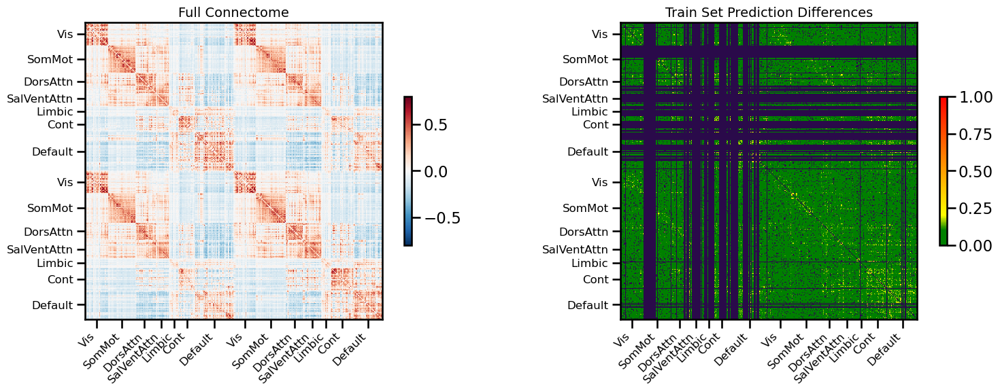

<Figure size 640x480 with 0 Axes>

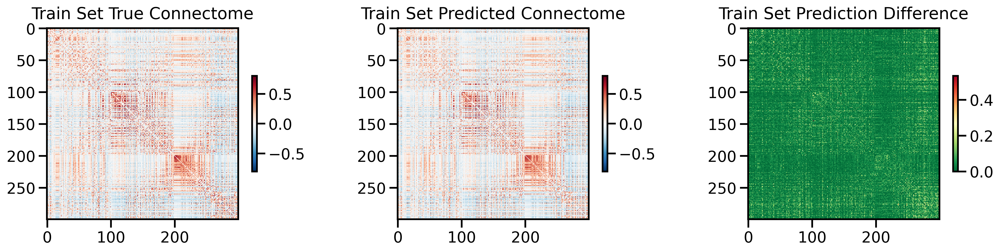

<Figure size 640x480 with 0 Axes>

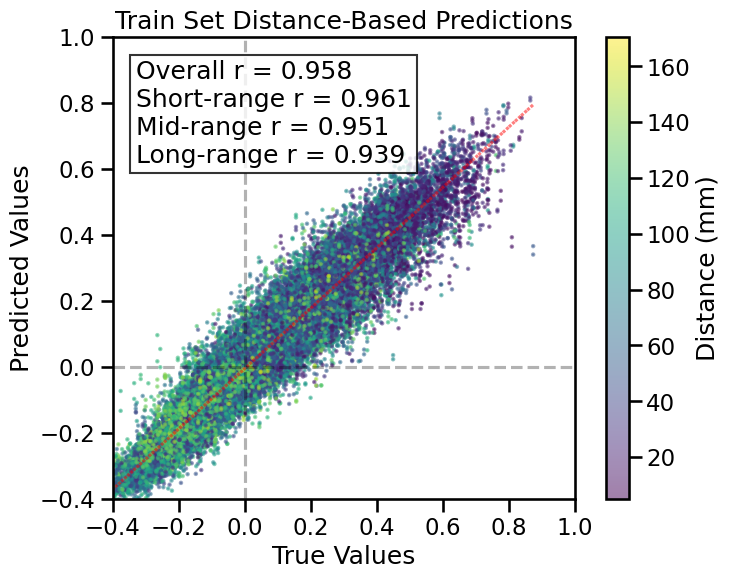

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 100 regions, 9900 connections


<Figure size 640x480 with 0 Axes>

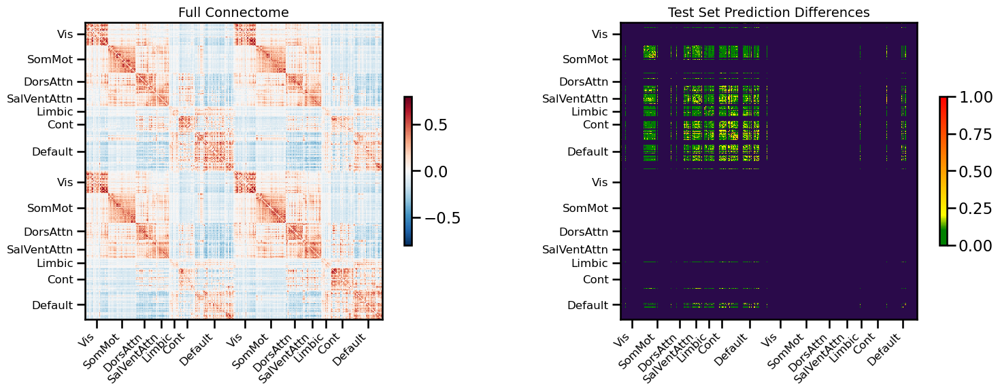

<Figure size 640x480 with 0 Axes>

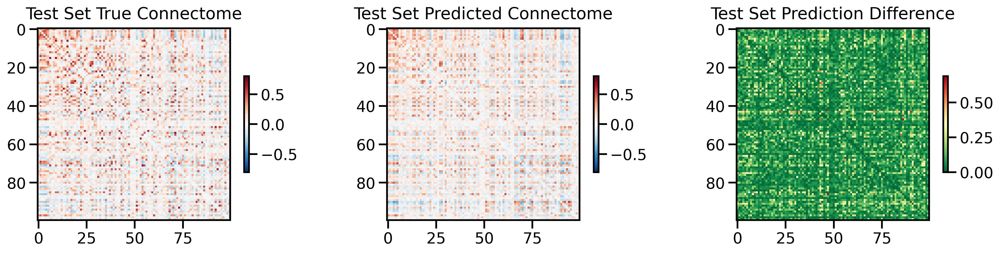

<Figure size 640x480 with 0 Axes>

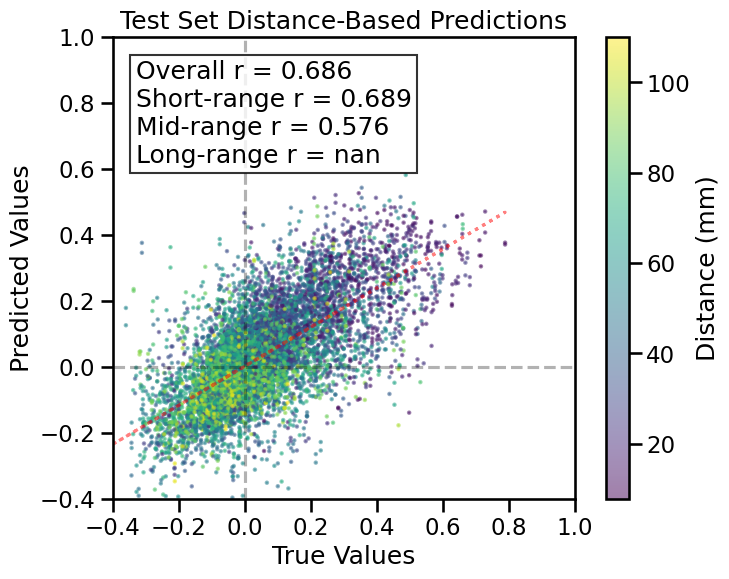

TRAIN METRICS
GLOBAL: mse=0.002889, mae=0.038495, r2=0.9160, pearson_r=0.9576, spearman_r=0.9561, geodesic_distance=15.5783
DISTANCE-BASED: short=0.9614, mid=0.9506, long=0.9385
HEMISPHERIC: left=0.9626, right=0.9571, inter=0.9590
CONNECTION STRENGTH: neg=0.5161, weak=0.9341, pos=0.7222
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9471    0.9505
  Default       0.9636    0.9531
  SalVentAttn    0.9319    0.9465
  Limbic        0.9206    0.9474
  DorsAttn      0.9479    0.9522
  SomMot        0.9505    0.9487
  Vis           0.9519    0.9502

TEST METRICS
GLOBAL: mse=0.015489, mae=0.089674, r2=0.4311, pearson_r=0.6858, spearman_r=0.6719, geodesic_distance=13.4934
DISTANCE-BASED: short=0.6889, mid=0.5765
HEMISPHERIC: left=0.6891, right=0.7268, inter=0.5776
CONNECTION STRENGTH: weak=0.6133, pos=0.2543
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.7228    0.6839
  Default 

0

<Figure size 640x480 with 0 Axes>

In [17]:
single_sim_run(
              feature_type=[{'transcriptome_PCA': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=True,
              dataset='HCP',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='spatial',
              random_seed=42,
              search_method=('wandb', 'mse', 4),
              track_wandb=False,
              skip_cv=True,
              model_type='dynamic_mlp',
              use_gpu=True,
              null_model='none',
              use_folds=[0]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 11988, Number of 0s: 195948, Class balance (1s): 0.058
X shape: (400, 7380)
X_pca shape: (400, 27)
X_cell_types_Jorstad shape: (400, 24)
X_cell_types_Lake_DFC shape: (400, 18)
X_cell_types_Lake_VIS shape: (400, 18)
Y_sc shape: (400, 400)
Y_sc_spectralL shape: (400, 399)
Y_sc_spectralA shape: (400, 400)
Y_fc shape: (400, 400)
Coordinates shape: (400, 3)
Y shape (400, 400)
Network coverage: 100.0% of regions
Network sizes: [100, 100, 100, 100]
feature_name: cell_types_Jorstad, processing_type: None
features ['cell_types_Jorstad']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: f2ouicbr
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/f2ouicbr
Initialized sweep with ID: f2ouicbr


  warnings.warn(



2
3
4
BEST CONFIG {'input_dim': 48, 'binarize': False, 'hidden_dims': [512, 256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.1, 'weight_decay': 0.0001, 'epochs': 125}
Number of learnable parameters in MLP: 191233
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.33 GB
Best val loss so far at epoch 1: 0.0383
Best val loss so far at epoch 2: 0.0330
Best val loss so far at epoch 3: 0.0312
Best val loss so far at epoch 4: 0.0298
Best val loss so far at epoch 5: 0.0292
Epoch 5/125, Train Loss: 0.0461, Val Loss: 0.0292, Time: 0.70s
Best val loss so far at epoch 6: 0.0286
Best val loss so far at epoch 7: 0.0282
Best val loss so far at epoch 8: 0.0279
Best val loss so far at epoch 9: 0.0278
Best val loss so far at epoch 10: 0.0274
Epoch 10/125, Train Loss: 0.0329, Val Loss: 0.0274, Time: 0.71s
Best val loss so far at epoch 12: 0.0274
Best val loss so far at epoch 14: 0.0274
Epoch 15/125, Train Loss: 0.0291, Val Loss: 0.0276, Time: 0.71s
Best val loss 

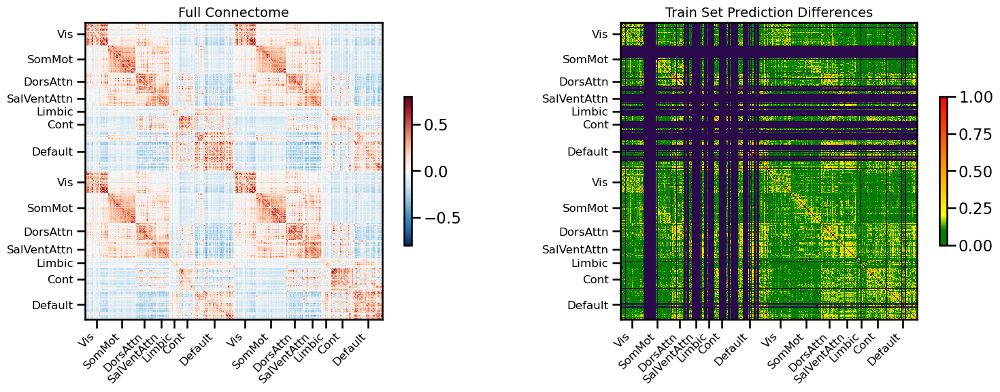

<Figure size 640x480 with 0 Axes>

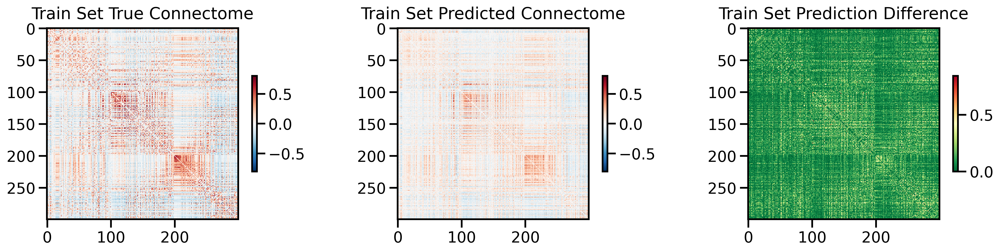

<Figure size 640x480 with 0 Axes>

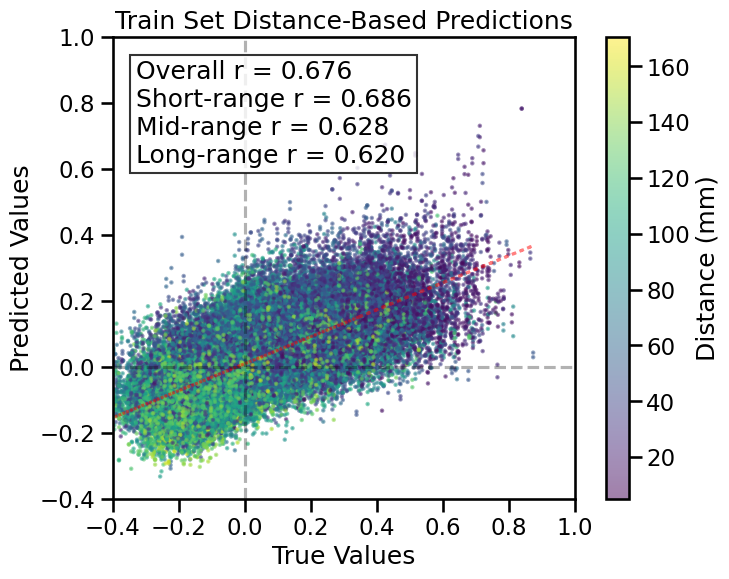

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 100 regions, 9900 connections


<Figure size 640x480 with 0 Axes>

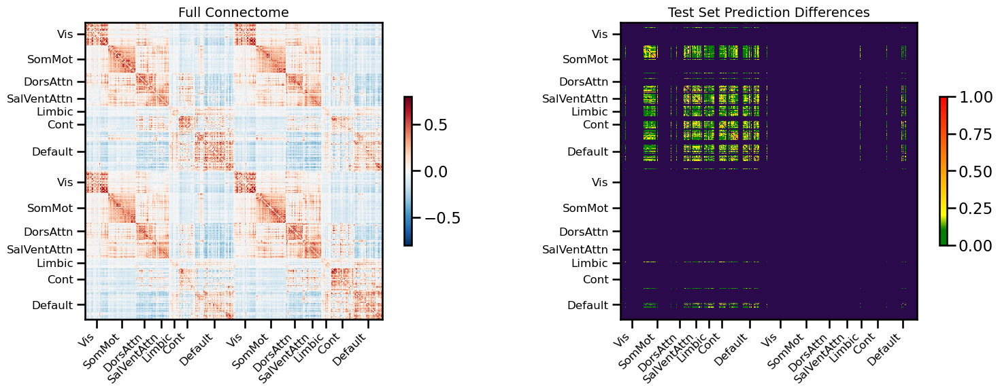

<Figure size 640x480 with 0 Axes>

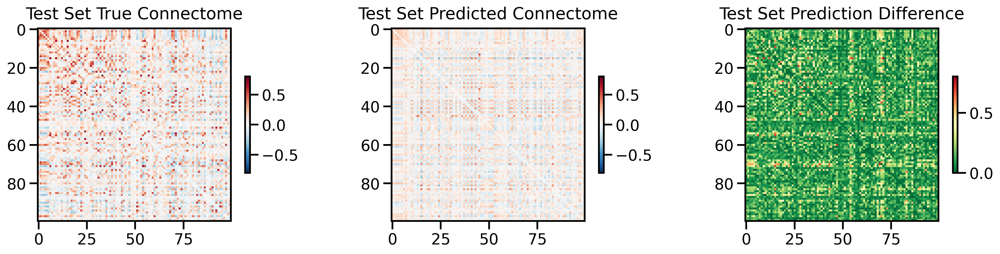

<Figure size 640x480 with 0 Axes>

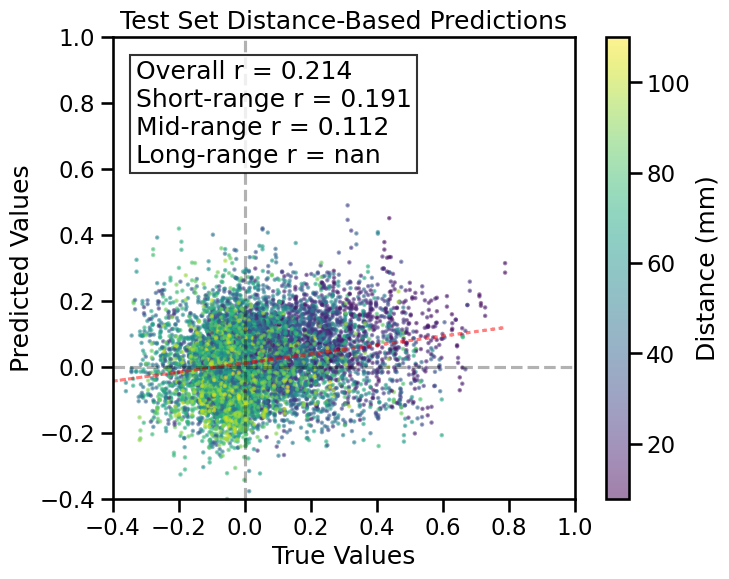

TRAIN METRICS
GLOBAL: mse=0.018846, mae=0.101478, r2=0.4519, pearson_r=0.6762, spearman_r=0.6841, geodesic_distance=29.9868
DISTANCE-BASED: short=0.6861, mid=0.6282, long=0.6198
HEMISPHERIC: left=0.6738, right=0.6812, inter=0.6724
CONNECTION STRENGTH: neg=0.0311, weak=0.6158, pos=0.2633
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.5926    0.6436
  Default       0.6765    0.6478
  SalVentAttn    0.6399    0.6683
  Limbic        0.4691    0.6358
  DorsAttn      0.6155    0.6316
  SomMot        0.6883    0.6414
  Vis           0.5926    0.6229

TEST METRICS
GLOBAL: mse=0.031494, mae=0.131897, r2=-0.1568, pearson_r=0.2141, spearman_r=0.2246, geodesic_distance=17.4200
DISTANCE-BASED: short=0.1908, mid=0.1123
HEMISPHERIC: left=0.2153, right=0.8689, inter=0.2481
CONNECTION STRENGTH: weak=0.1823, pos=0.0035
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.1621    0.1637
  Default

0

<Figure size 640x480 with 0 Axes>

In [18]:
single_sim_run(
              feature_type=[{'cell_types_Jorstad': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=True,
              dataset='HCP',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='spatial',
              random_seed=42,
              search_method=('wandb', 'mse', 4),
              track_wandb=False,
              skip_cv=True,
              model_type='dynamic_mlp',
              use_gpu=True,
              null_model='none',
              use_folds=[0]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 11988, Number of 0s: 195948, Class balance (1s): 0.058
X shape: (400, 7380)
X_pca shape: (400, 27)
X_cell_types_Jorstad shape: (400, 24)
X_cell_types_Lake_DFC shape: (400, 18)
X_cell_types_Lake_VIS shape: (400, 18)
Y_sc shape: (400, 400)
Y_sc_spectralL shape: (400, 399)
Y_sc_spectralA shape: (400, 400)
Y_fc shape: (400, 400)
Coordinates shape: (400, 3)
Y shape (400, 400)
Network coverage: 100.0% of regions
Network sizes: [100, 100, 100, 100]
feature_name: transcriptome_PCA, processing_type: None
feature_name: cell_types_Jorstad, processing_type: None
feature_name: cell_types_Lake_DFC, processing_type: None
feature_name: cell_types_Lake_VIS, processing_type: None
features ['transcriptome_PCA', 'cell_types_Jorstad', 'cell_types_Lake_DFC', 'cell_types_Lake_VIS']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: wal1s506
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/wal1s506
Initialized sweep with ID: wal1s506


  warnings.warn(



2
3
4
BEST CONFIG {'input_dim': 174, 'binarize': False, 'hidden_dims': [512, 256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.1, 'weight_decay': 0.0001, 'epochs': 125}
Number of learnable parameters in MLP: 255745
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.33 GB
Best val loss so far at epoch 1: 0.0352
Best val loss so far at epoch 2: 0.0294
Best val loss so far at epoch 3: 0.0253
Best val loss so far at epoch 4: 0.0242
Best val loss so far at epoch 5: 0.0221
Epoch 5/125, Train Loss: 0.0373, Val Loss: 0.0221, Time: 0.71s
Best val loss so far at epoch 6: 0.0218
Best val loss so far at epoch 7: 0.0208
Best val loss so far at epoch 8: 0.0202
Best val loss so far at epoch 9: 0.0199
Best val loss so far at epoch 10: 0.0195
Epoch 10/125, Train Loss: 0.0226, Val Loss: 0.0195, Time: 0.73s
Best val loss so far at epoch 11: 0.0192
Best val loss so far at epoch 12: 0.0190
Best val loss so far at epoch 13: 0.0186
Best val loss so far at epoch 14: 0.

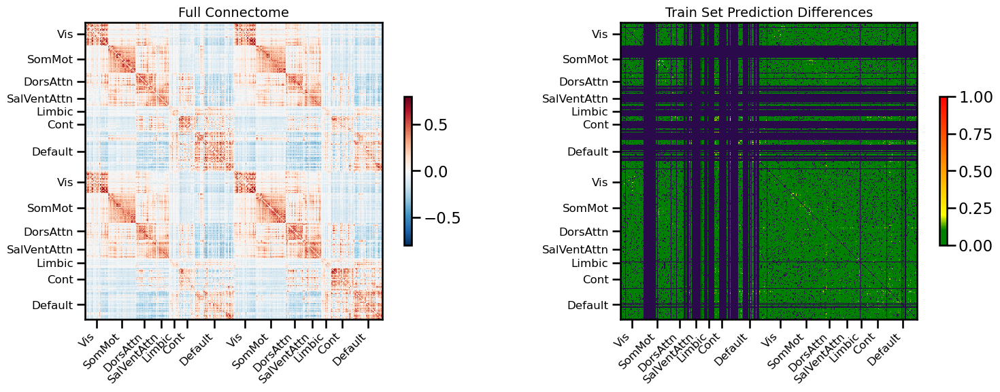

<Figure size 640x480 with 0 Axes>

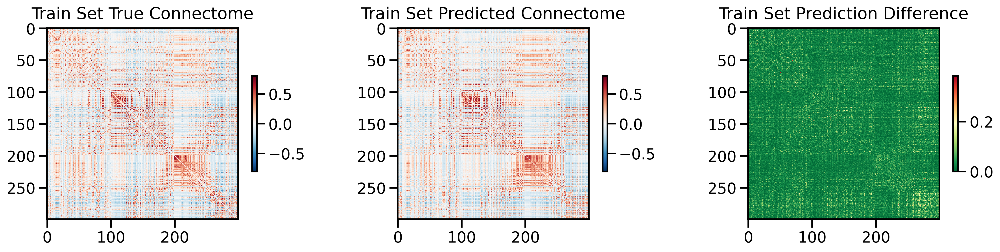

<Figure size 640x480 with 0 Axes>

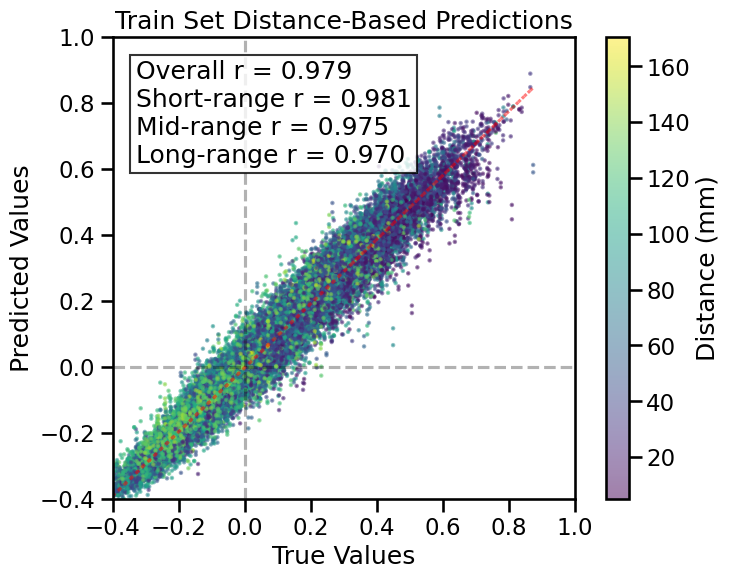

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 100 regions, 9900 connections


<Figure size 640x480 with 0 Axes>

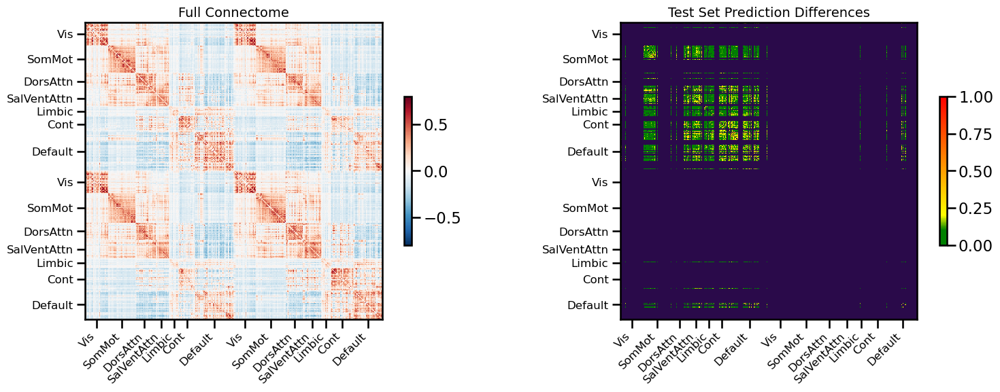

<Figure size 640x480 with 0 Axes>

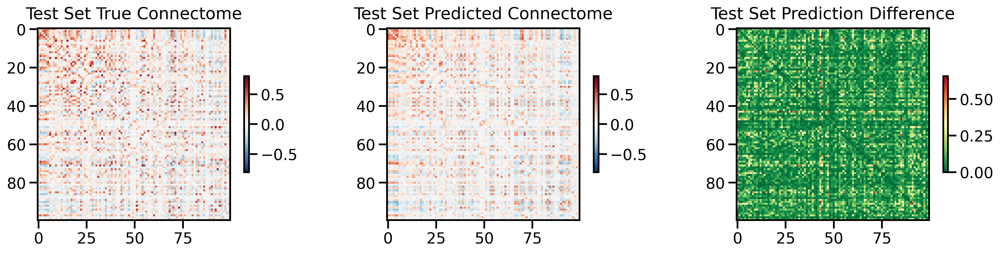

<Figure size 640x480 with 0 Axes>

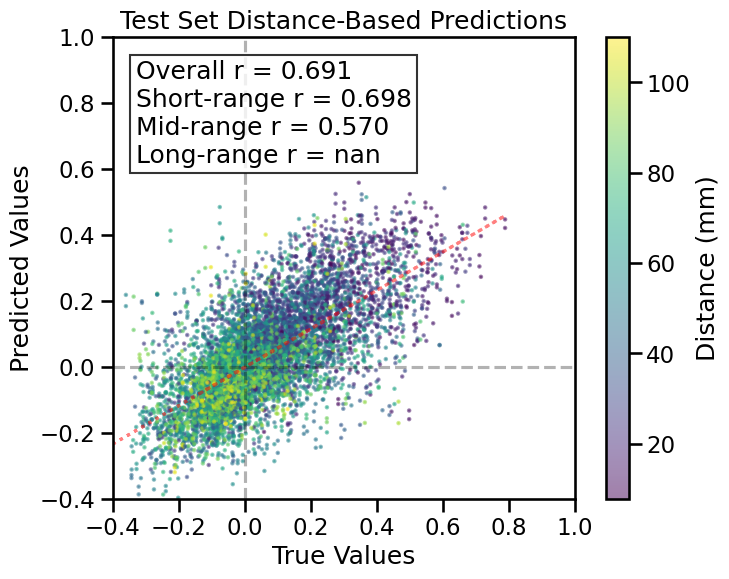

TRAIN METRICS
GLOBAL: mse=0.001444, mae=0.027574, r2=0.9580, pearson_r=0.9789, spearman_r=0.9771, geodesic_distance=12.6272
DISTANCE-BASED: short=0.9813, mid=0.9750, long=0.9696
HEMISPHERIC: left=0.9807, right=0.9797, inter=0.9803
CONNECTION STRENGTH: neg=0.6715, weak=0.9658, pos=0.8411
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9779    0.9760
  Default       0.9808    0.9769
  SalVentAttn    0.9737    0.9761
  Limbic        0.9824    0.9757
  DorsAttn      0.9797    0.9769
  SomMot        0.9762    0.9752
  Vis           0.9754    0.9744

TEST METRICS
GLOBAL: mse=0.015179, mae=0.087921, r2=0.4424, pearson_r=0.6911, spearman_r=0.6718, geodesic_distance=12.2914
DISTANCE-BASED: short=0.6975, mid=0.5700
HEMISPHERIC: left=0.6995, right=0.5874, inter=0.6156
CONNECTION STRENGTH: weak=0.6169, pos=0.2755
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.7611    0.6917
  Default 

0

<Figure size 640x480 with 0 Axes>

In [19]:
single_sim_run(
              feature_type=[
                {'transcriptome_PCA': None},
                {'cell_types_Jorstad': None},
                {'cell_types_Lake_DFC': None},
                {'cell_types_Lake_VIS': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=True,
              dataset='HCP',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='spatial',
              random_seed=42,
              search_method=('wandb', 'mse', 4),
              track_wandb=False,
              skip_cv=True,
              model_type='dynamic_mlp',
              use_gpu=True,
              null_model='none',
              use_folds=[0]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 11988, Number of 0s: 195948, Class balance (1s): 0.058
X shape: (400, 7380)
X_pca shape: (400, 27)
X_cell_types_Jorstad shape: (400, 24)
X_cell_types_Lake_DFC shape: (400, 18)
X_cell_types_Lake_VIS shape: (400, 18)
Y_sc shape: (400, 400)
Y_sc_spectralL shape: (400, 399)
Y_sc_spectralA shape: (400, 400)
Y_fc shape: (400, 400)
Coordinates shape: (400, 3)
Y shape (400, 400)
Network coverage: 100.0% of regions
Network sizes: [100, 100, 100, 100]
feature_name: transcriptome, processing_type: None
feature_name: transcriptome_PCA, processing_type: None
feature_name: cell_types_Jorstad, processing_type: None
feature_name: cell_types_Lake_DFC, processing_type: None
feature_name: cell_types_Lake_VIS, processing_type: None
features ['transcriptome', 'transcriptome_PCA', 'cell_types_Jorstad', 'cell_types_Lake_DFC', 'cell_types_Lake_VIS']
Feature matrix, X, generated... e

  return LooseVersion(v) >= LooseVersion(check)

ERROR: Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: asratzan (alexander-ratzan-new-york-university). Use `wandb login --relogin` to force relogin
wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: wwv6qlet
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/wwv6qlet
Initialized sweep with ID: wwv6qlet
2
3
4
BEST CONFIG {'input_dim': 14934, 'binarize': False, 'hidden_dims': [512, 256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.1, 'weight_decay': 0.0001, 'epochs': 125}


  warnings.warn(



Number of learnable parameters in MLP: 7812865
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.0340
Best val loss so far at epoch 2: 0.0235
Best val loss so far at epoch 3: 0.0218
Best val loss so far at epoch 5: 0.0203
Epoch 5/125, Train Loss: 0.0330, Val Loss: 0.0203, Time: 1.53s
Best val loss so far at epoch 7: 0.0187
Best val loss so far at epoch 10: 0.0164
Epoch 10/125, Train Loss: 0.0137, Val Loss: 0.0164, Time: 1.60s
Best val loss so far at epoch 12: 0.0158
Epoch 15/125, Train Loss: 0.0070, Val Loss: 0.0172, Time: 1.62s
Best val loss so far at epoch 18: 0.0152
Epoch 20/125, Train Loss: 0.0046, Val Loss: 0.0212, Time: 1.57s
Best val loss so far at epoch 21: 0.0128
Epoch 25/125, Train Loss: 0.0038, Val Loss: 0.0133, Time: 1.58s
Best val loss so far at epoch 26: 0.0126
Best val loss so far at epoch 28: 0.0124
Epoch 30/125, Train Loss: 0.0032, Val Loss: 0.0211, Time: 1.65s
Epoch 35/125, Train Loss: 0.0029, Val Loss: 0.01

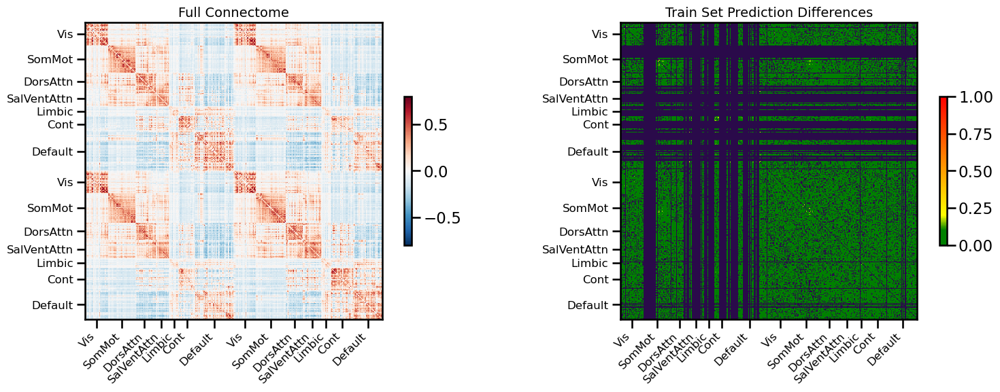

<Figure size 640x480 with 0 Axes>

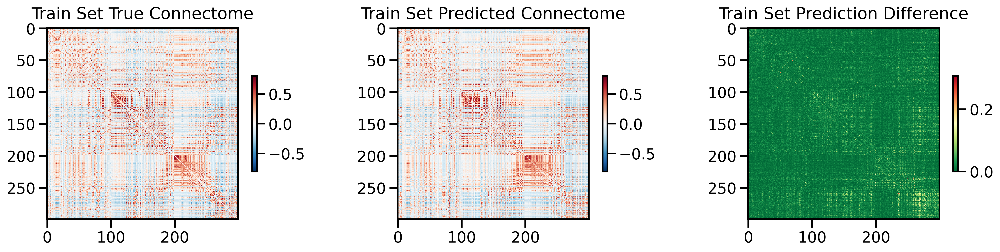

<Figure size 640x480 with 0 Axes>

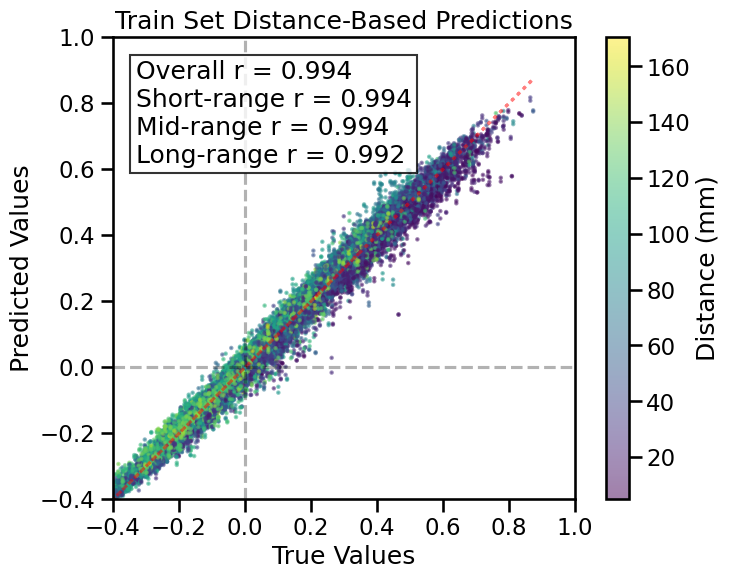

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 100 regions, 9900 connections


<Figure size 640x480 with 0 Axes>

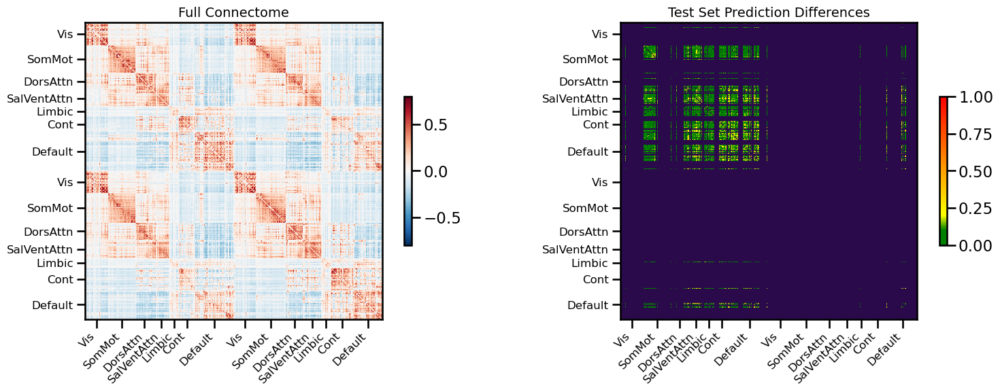

<Figure size 640x480 with 0 Axes>

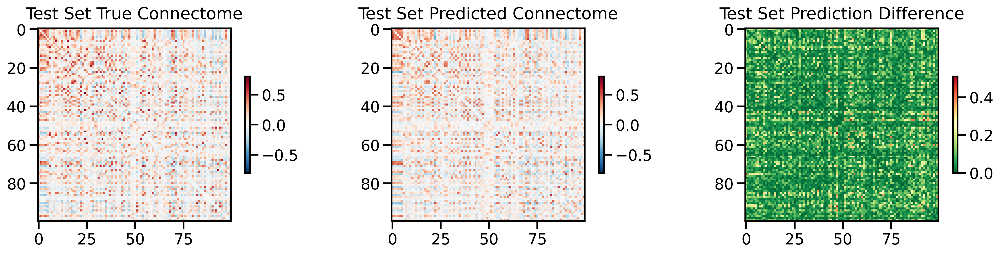

<Figure size 640x480 with 0 Axes>

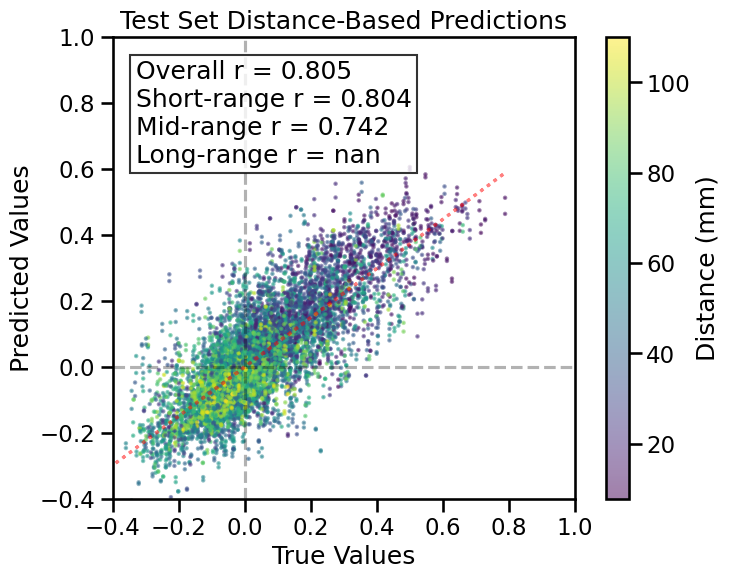

TRAIN METRICS
GLOBAL: mse=0.000432, mae=0.014505, r2=0.9874, pearson_r=0.9938, spearman_r=0.9940, geodesic_distance=9.3342
DISTANCE-BASED: short=0.9939, mid=0.9936, long=0.9918
HEMISPHERIC: left=0.9919, right=0.9956, inter=0.9947
CONNECTION STRENGTH: neg=0.8661, weak=0.9909, pos=0.9326
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9959    0.9946
  Default       0.9954    0.9949
  SalVentAttn    0.9941    0.9949
  Limbic        0.9952    0.9944
  DorsAttn      0.9946    0.9947
  SomMot        0.9949    0.9944
  Vis           0.9942    0.9942

TEST METRICS
GLOBAL: mse=0.010082, mae=0.072543, r2=0.6296, pearson_r=0.8051, spearman_r=0.7795, geodesic_distance=8.2719
DISTANCE-BASED: short=0.8039, mid=0.7421
HEMISPHERIC: left=0.8204, right=0.4254, inter=0.5648
CONNECTION STRENGTH: weak=0.7239, pos=0.4512
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.8215    0.7933
  Default   

0

<Figure size 640x480 with 0 Axes>

In [8]:
single_sim_run(
              feature_type=[
                {'transcriptome': None},
                {'transcriptome_PCA': None},
                {'cell_types_Jorstad': None},
                {'cell_types_Lake_DFC': None},
                {'cell_types_Lake_VIS': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=True,
              dataset='HCP',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='spatial',
              random_seed=42,
              search_method=('wandb', 'mse', 4),
              track_wandb=False,
              skip_cv=True,
              model_type='dynamic_mlp',
              use_gpu=True,
              null_model='none',
              use_folds=[0]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

#### Quick random analysis

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 11988, Number of 0s: 195948, Class balance (1s): 0.058
X shape: (400, 7380)
X_pca shape: (400, 27)
X_cell_types_Jorstad shape: (400, 24)
X_cell_types_Lake_DFC shape: (400, 18)
X_cell_types_Lake_VIS shape: (400, 18)
Y_sc shape: (400, 400)
Y_sc_spectralL shape: (400, 399)
Y_sc_spectralA shape: (400, 400)
Y_fc shape: (400, 400)
Coordinates shape: (400, 3)
Y shape (400, 400)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: xfblx81g
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/xfblx81g
Initialized sweep with ID: xfblx81g


  warnings.warn(



2
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'hidden_dims': [512, 256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.1, 'weight_decay': 0.0001, 'epochs': 125}
Number of learnable parameters in MLP: 7723777
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.09 GB
Best val loss so far at epoch 1: 15.2209
Best val loss so far at epoch 2: 0.0250
Best val loss so far at epoch 3: 0.0217
Best val loss so far at epoch 4: 0.0214
Best val loss so far at epoch 5: 0.0196
Epoch 5/125, Train Loss: 0.0376, Val Loss: 0.0196, Time: 1.54s
Best val loss so far at epoch 8: 0.0182
Best val loss so far at epoch 9: 0.0176
Epoch 10/125, Train Loss: 0.0165, Val Loss: 0.0192, Time: 1.55s
Best val loss so far at epoch 12: 0.0172
Epoch 15/125, Train Loss: 0.0086, Val Loss: 0.0176, Time: 1.58s
Best val loss so far at epoch 16: 0.0166
Best val loss so far at epoch 20: 0.0157
Epoch 20/125, Train Loss: 0.0059, Val Loss: 0.0157, Time: 1.58s
Epoch 25/125, Train Loss:

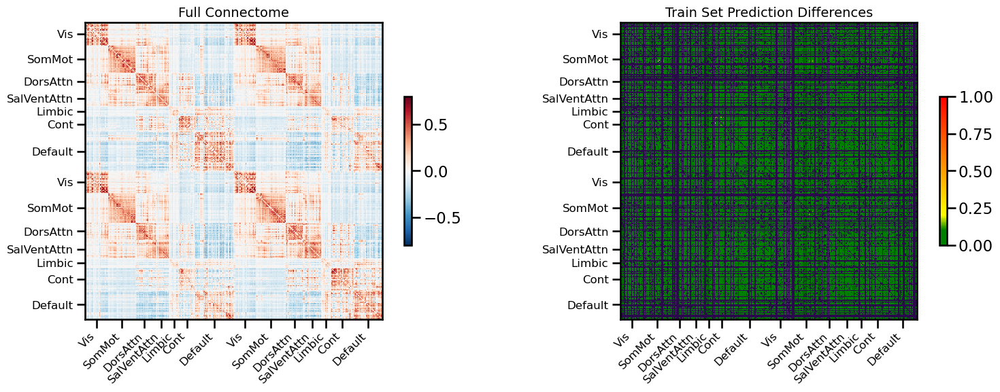

<Figure size 640x480 with 0 Axes>

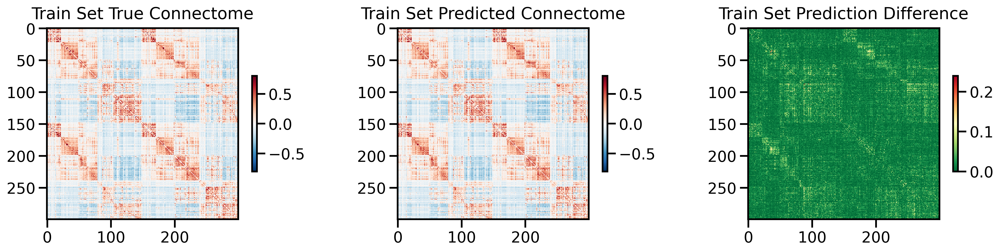

<Figure size 640x480 with 0 Axes>

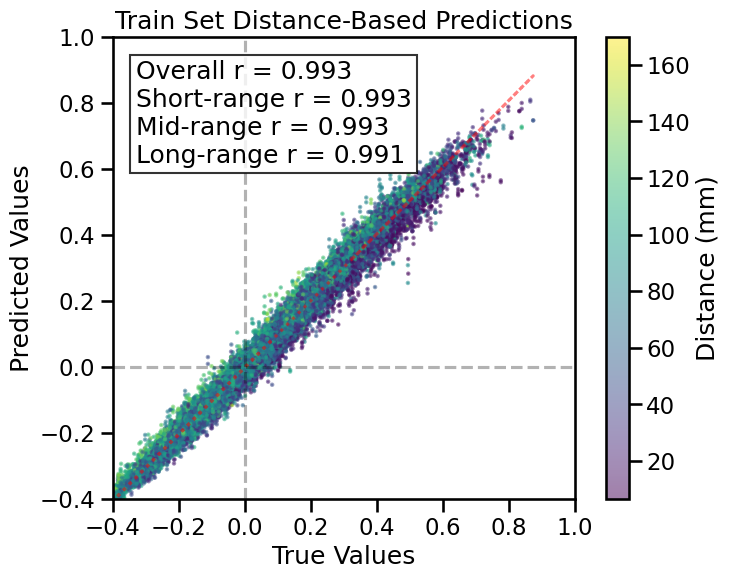

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 100 regions, 9900 connections


<Figure size 640x480 with 0 Axes>

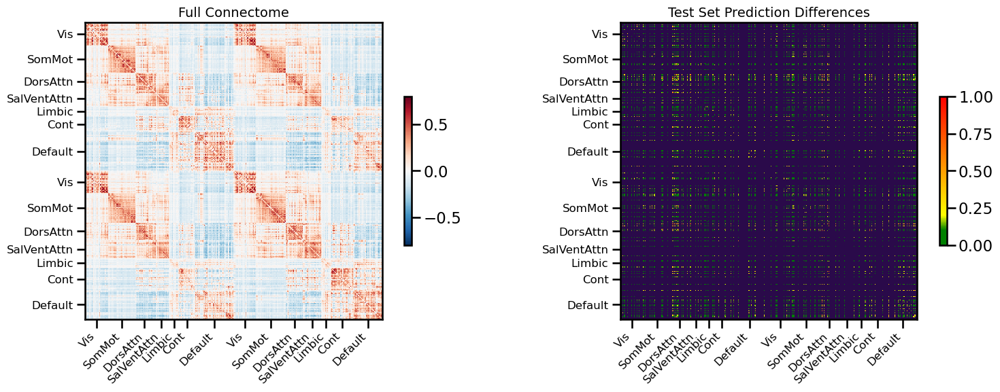

<Figure size 640x480 with 0 Axes>

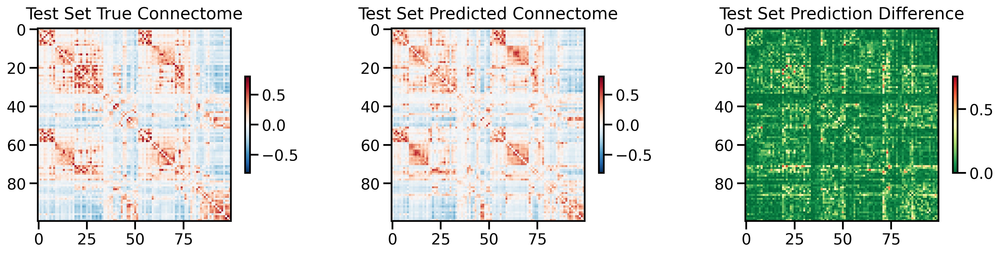

<Figure size 640x480 with 0 Axes>

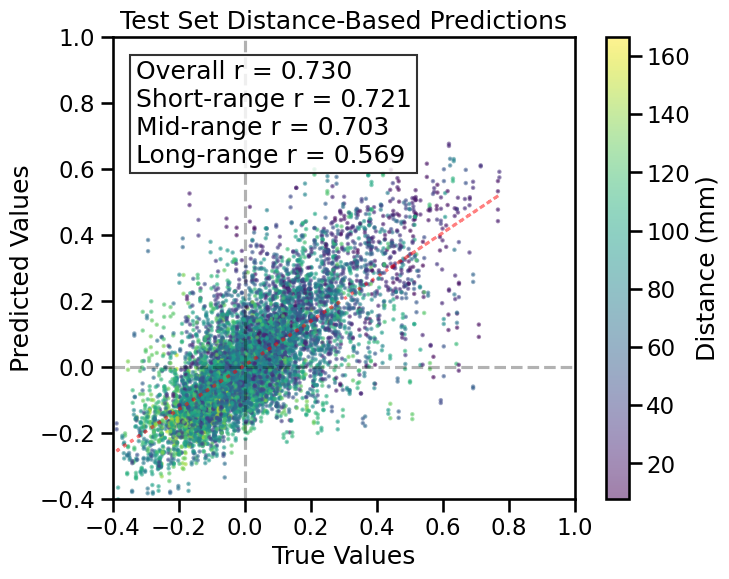

TRAIN METRICS
GLOBAL: mse=0.000469, mae=0.015791, r2=0.9844, pearson_r=0.9925, spearman_r=0.9918, geodesic_distance=9.1028
DISTANCE-BASED: short=0.9926, mid=0.9925, long=0.9912
HEMISPHERIC: left=0.9926, right=0.9945, inter=0.9930
CONNECTION STRENGTH: neg=0.8793, weak=0.9888, pos=0.9226
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9939    0.9922
  Default       0.9889    0.9920
  SalVentAttn    0.9913    0.9915
  Limbic        0.9916    0.9913
  DorsAttn      0.9921    0.9923
  SomMot        0.9934    0.9929
  Vis           0.9910    0.9909

TEST METRICS
GLOBAL: mse=0.014928, mae=0.084608, r2=0.4992, pearson_r=0.7304, spearman_r=0.7169, geodesic_distance=9.4649
DISTANCE-BASED: short=0.7212, mid=0.7030, long=0.5690
HEMISPHERIC: left=0.7159, right=0.7368, inter=0.7345
CONNECTION STRENGTH: neg=0.3122, weak=0.6613, pos=0.2337
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.72

0

<Figure size 640x480 with 0 Axes>

In [9]:
single_sim_run(
              feature_type=[
                {'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=True,
              dataset='HCP',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 4),
              track_wandb=False,
              skip_cv=True,
              model_type='dynamic_mlp',
              use_gpu=True,
              null_model='none',
              use_folds=[0]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 11988, Number of 0s: 195948, Class balance (1s): 0.058
X shape: (400, 7380)
X_pca shape: (400, 27)
X_cell_types_Jorstad shape: (400, 24)
X_cell_types_LakeDFC shape: (400, 18)
X_cell_types_LakeVIS shape: (400, 18)
Y_sc shape: (400, 400)
Y_sc_spectralL shape: (400, 399)
Y_sc_spectralA shape: (400, 400)
Y_fc shape: (400, 400)
Coordinates shape: (400, 3)
Y shape (400, 400)
feature_name: transcriptome, processing_type: None
feature_name: Jorstad, processing_type: None
feature_name: LakeDFC, processing_type: None
feature_name: LakeVIS, processing_type: None
features ['transcriptome', 'Jorstad', 'LakeDFC', 'LakeVIS']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: mzrggdao
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/mzrggdao
Initialized sweep with ID: mzrggdao
2
3
4


  warnings.warn(

  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



BEST CONFIG {'input_dim': 14880, 'binarize': False, 'hidden_dims': [512, 256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.1, 'weight_decay': 0.0001, 'epochs': 125}
Number of learnable parameters in MLP: 7785217


  from IPython.core.display import display



  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.24 GB
Best val loss so far at epoch 1: 0.0310
Best val loss so far at epoch 2: 0.0248
Best val loss so far at epoch 3: 0.0230
Best val loss so far at epoch 5: 0.0217
Epoch 5/125, Train Loss: 0.0407, Val Loss: 0.0217, Time: 1.72s
Best val loss so far at epoch 7: 0.0195
Best val loss so far at epoch 8: 0.0185
Epoch 10/125, Train Loss: 0.0179, Val Loss: 0.0201, Time: 1.59s
Best val loss so far at epoch 11: 0.0163
Epoch 15/125, Train Loss: 0.0091, Val Loss: 0.0212, Time: 1.70s
Epoch 20/125, Train Loss: 0.0058, Val Loss: 0.0245, Time: 1.65s
Epoch 25/125, Train Loss: 0.0043, Val Loss: 0.0225, Time: 1.70s
Epoch 30/125, Train Loss: 0.0037, Val Loss: 0.0205, Time: 2.01s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.022241
Epoch 35/125, Train Loss: 0.0027, Val Loss: 0.0168, Time: 1.83s
Best val loss so far at epoch 36: 0.0161
Best val loss so far at epoch 39: 0.0158
Epoch 40/125, Train Loss: 0.0026, Val Loss: 0.0179, Time: 1

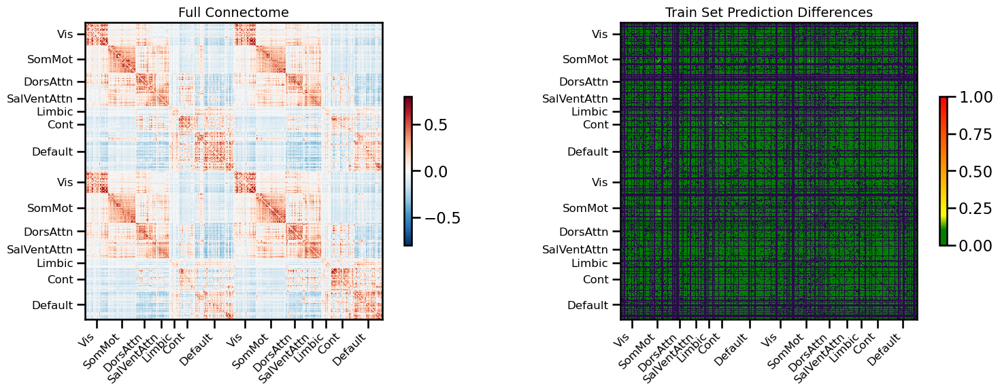

<Figure size 640x480 with 0 Axes>

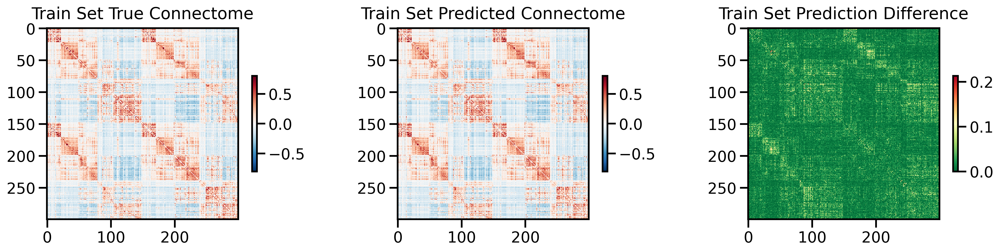

<Figure size 640x480 with 0 Axes>

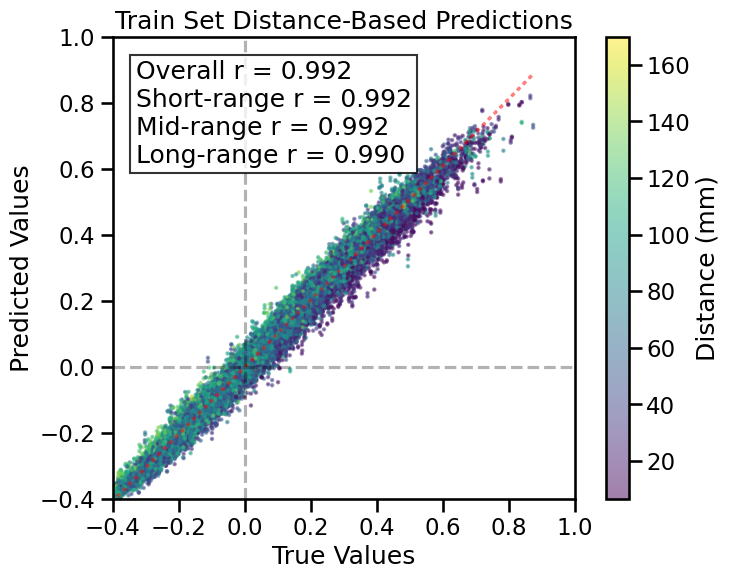

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 100 regions, 9900 connections


<Figure size 640x480 with 0 Axes>

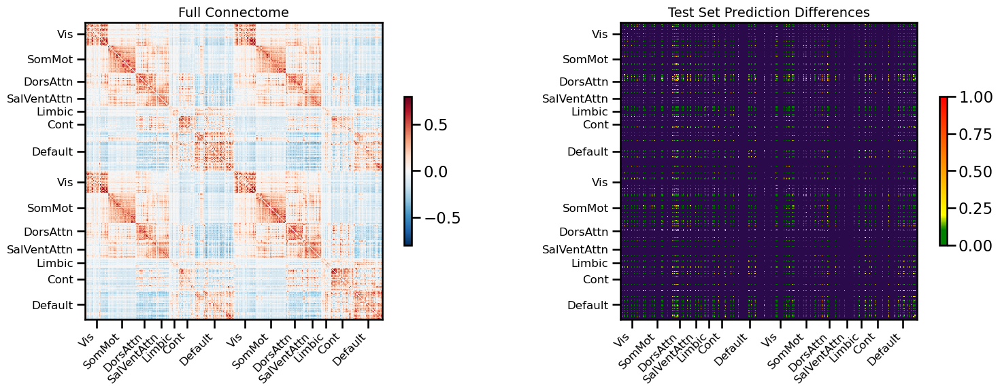

<Figure size 640x480 with 0 Axes>

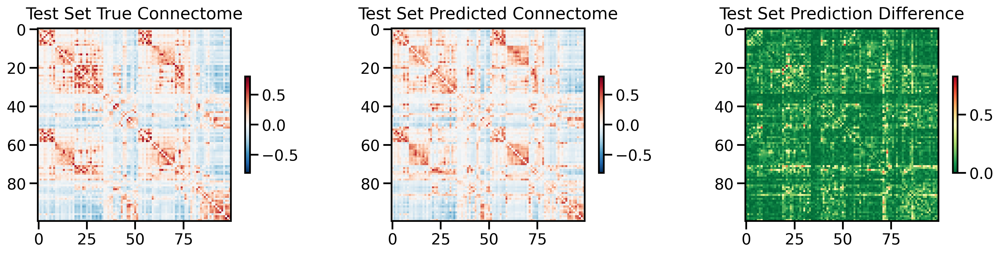

<Figure size 640x480 with 0 Axes>

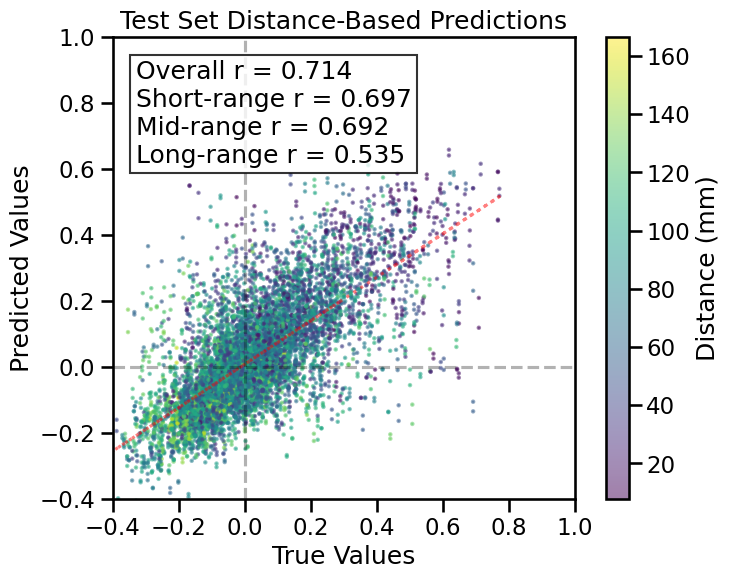

TRAIN METRICS
GLOBAL: mse=0.000520, mae=0.016678, r2=0.9827, pearson_r=0.9918, spearman_r=0.9911, geodesic_distance=9.2386
DISTANCE-BASED: short=0.9920, mid=0.9918, long=0.9905
HEMISPHERIC: left=0.9916, right=0.9935, inter=0.9927
CONNECTION STRENGTH: neg=0.8621, weak=0.9876, pos=0.9196
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9935    0.9918
  Default       0.9892    0.9917
  SalVentAttn    0.9912    0.9909
  Limbic        0.9915    0.9906
  DorsAttn      0.9927    0.9918
  SomMot        0.9933    0.9925
  Vis           0.9907    0.9904

TEST METRICS
GLOBAL: mse=0.015902, mae=0.086294, r2=0.4664, pearson_r=0.7140, spearman_r=0.7077, geodesic_distance=9.7040
DISTANCE-BASED: short=0.6968, mid=0.6922, long=0.5346
HEMISPHERIC: left=0.7020, right=0.7175, inter=0.7155
CONNECTION STRENGTH: neg=0.3056, weak=0.6421, pos=0.2156
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.66

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▅▄▄▅▃▃▂▅▅▂▃▄▅▁▁▂▂▁▃▂▂▂▃▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_mse_loss,█▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.01629
train_mse_loss,0.00154


Final evaluation metrics logged successfully.
CPU Usage: 1.2%
RAM Usage: 9.0%
Available RAM: 1.3T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 223.52 seconds (3.73 minutes)


0

<Figure size 640x480 with 0 Axes>

In [10]:
single_sim_run(
              feature_type=[
                {'transcriptome': None},
                {'Jorstad': None},
                {'LakeDFC': None},
                {'LakeVIS': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=True,
              dataset='HCP',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 4),
              track_wandb=True,
              skip_cv=True,
              model_type='dynamic_mlp',
              use_gpu=True,
              null_model='none',
              use_folds=[0]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 11988, Number of 0s: 195948, Class balance (1s): 0.058
X shape: (400, 7380)
X_pca shape: (400, 27)
X_cell_types_Jorstad shape: (400, 24)
X_cell_types_Lake_DFC shape: (400, 18)
X_cell_types_Lake_VIS shape: (400, 18)
Y_sc shape: (400, 400)
Y_sc_spectralL shape: (400, 399)
Y_sc_spectralA shape: (400, 400)
Y_fc shape: (400, 400)
Coordinates shape: (400, 3)
Y shape (400, 400)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: qypgujqj
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/qypgujqj
Initialized sweep with ID: qypgujqj


  warnings.warn(



2
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'use_attention_pooling': False, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 0.0001, 'weight_decay': 0.0001, 'batch_size': 1024, 'aug_prob': 0.3, 'epochs': 100, 'num_workers': 2, 'prefetch_factor': 4}
Number of learnable parameters in SMT model: 2162315
Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.07 GB
Best val loss so far at epoch 1: 0.0388
Best val loss so far at epoch 2: 0.0354
Best val loss so far at epoch 4: 0.0296
Best val loss so far at epoch 5: 0.0285
Epoch 5/100, Train Loss: 0.0650, Val Loss: 0.0285, Time: 7.07s
Best val loss so far at epoch 6: 0.0273
Best val loss so far at epoch 7: 0.0262
Best val loss so far at epoch 9: 0.0249
Best val loss so far at epoch 10: 0.0237
Epoch 10/100, Tra

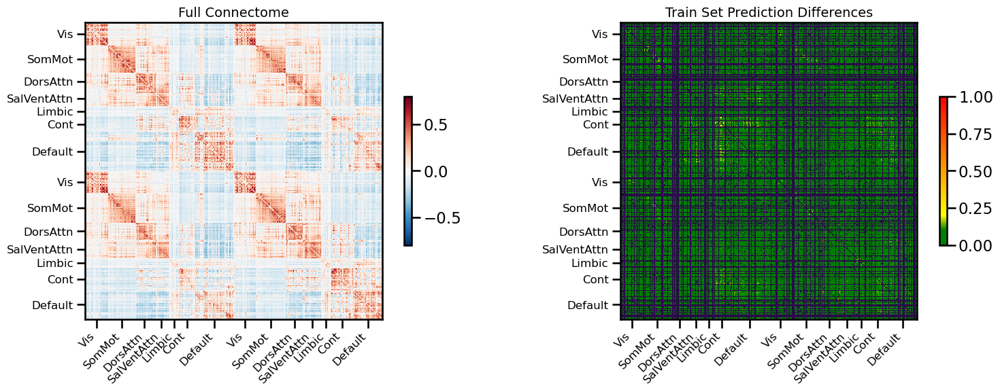

<Figure size 640x480 with 0 Axes>

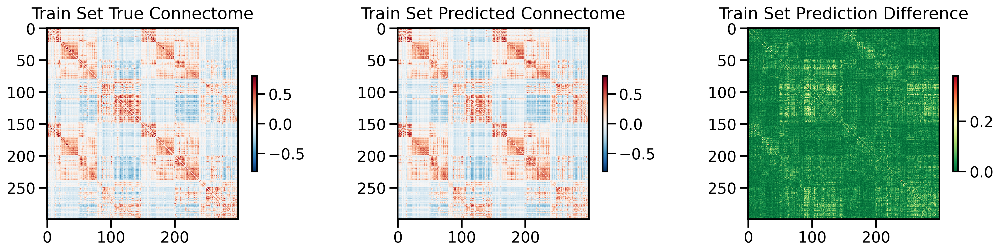

<Figure size 640x480 with 0 Axes>

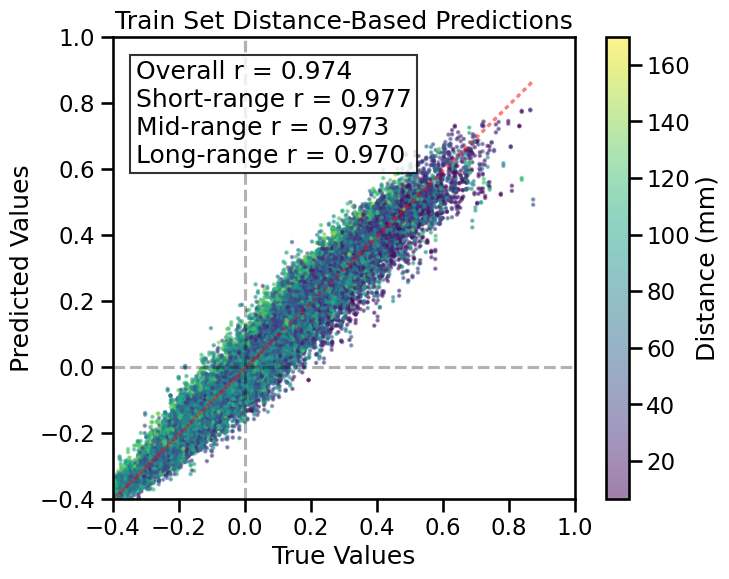

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 100 regions, 9900 connections


<Figure size 640x480 with 0 Axes>

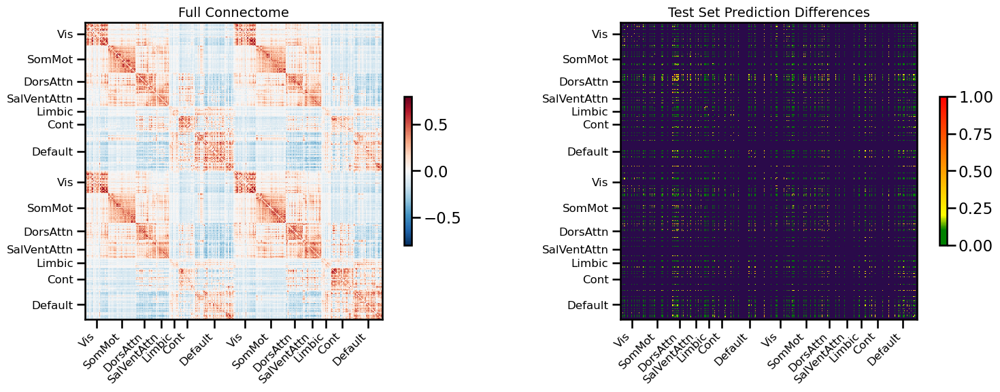

<Figure size 640x480 with 0 Axes>

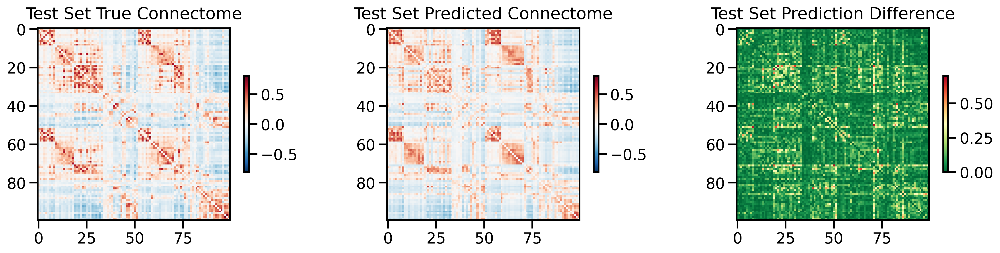

<Figure size 640x480 with 0 Axes>

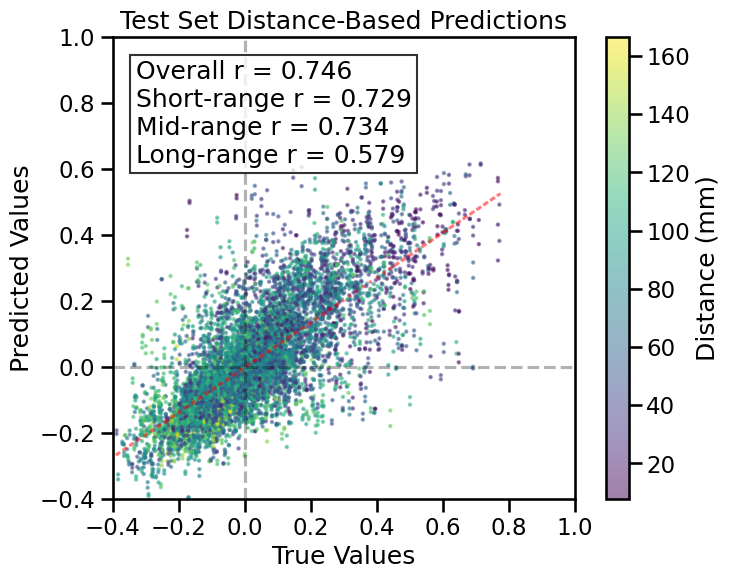

TRAIN METRICS
GLOBAL: mse=0.001613, mae=0.028902, r2=0.9463, pearson_r=0.9744, spearman_r=0.9722, geodesic_distance=12.2773
DISTANCE-BASED: short=0.9766, mid=0.9728, long=0.9705
HEMISPHERIC: left=0.9746, right=0.9804, inter=0.9777
CONNECTION STRENGTH: neg=0.7282, weak=0.9620, pos=0.7708
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9841    0.9786
  Default       0.9719    0.9773
  SalVentAttn    0.9702    0.9758
  Limbic        0.9741    0.9767
  DorsAttn      0.9867    0.9793
  SomMot        0.9821    0.9800
  Vis           0.9754    0.9735

TEST METRICS
GLOBAL: mse=0.014087, mae=0.081939, r2=0.5274, pearson_r=0.7460, spearman_r=0.7375, geodesic_distance=10.1377
DISTANCE-BASED: short=0.7288, mid=0.7343, long=0.5786
HEMISPHERIC: left=0.7149, right=0.7679, inter=0.7456
CONNECTION STRENGTH: neg=0.1903, weak=0.6786, pos=0.2991
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.

11966

<Figure size 640x480 with 0 Axes>

In [12]:
single_sim_run(
              feature_type=[
                {'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=True,
              dataset='HCP',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 4),
              track_wandb=False,
              skip_cv=True,
              model_type='shared_transformer',
              use_gpu=True,
              null_model='none',
              use_folds=[0]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()